# Variational Inference Experiments
This notebook demonstrates the use of the BayesVI.jl implementation which performs stochastic variational inference with mean field and Gaussian fixed form assumptions. The notebook first shows accounting for epistemic uncertanty as per Tensorflow Probability's case 3 example. And then it shows results for three synthetic regression datasets. All datasets are generated by the Datasets.jl module. The VI implementation in Julia here is mostly a port from the Autograd implementation of stochastic VI in Python (Ranganath, 2013) and (Duvenaud, 2015).

! NOTE ! This notebook usually takes ~3 minutes to run.

## Bayesian Neural Network Using Blackbox Stochastic Variational Inference

In [1]:
begin
    using Plots
    using Distributions
    using Random
    using Flux
    include("./BayesVI.jl")
    using .BayesVI
    include("./Datasets.jl")
    using .Datasets
end

┌ Info: OMEinsum loaded the CUDA module successfully
└ @ OMEinsum C:\Users\andre\.julia\packages\OMEinsum\0C2IK\src\cueinsum.jl:117


In [2]:
begin
    # Set random seed for reproducibility.
    Random.seed!(0);
    # Draw 10 models from learned posteriors for visualisation.
    number_of_models = 10;
    # Use 20 Monte Carlo samples to approximate gradient.
    mc_samples = 20;
end

20

## TFP Case 3 - Epistemic Uncertainty

┌ Info: Saved animation to 
│   fn = C:\Users\andre\idea_projects\julia\CS5099\tmp.gif
└ @ Plots C:\Users\andre\.julia\packages\Plots\Ra8fG\src\animation.jl:126


Plots.AnimatedGif("C:\\Users\\andre\\idea_projects\\julia\\CS5099\\tmp.gif")
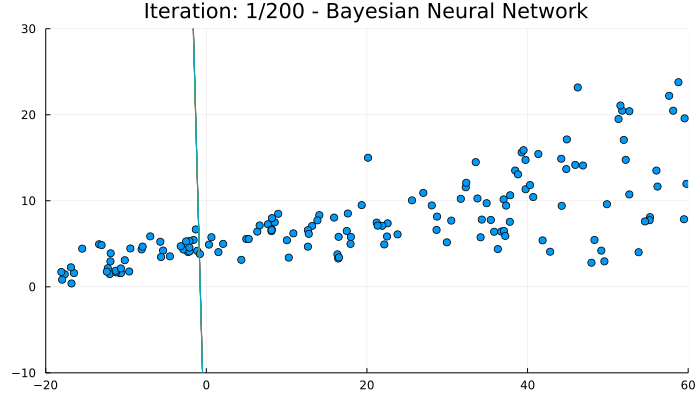

In [3]:
begin
    num_weights, prediction_fn, logprob, ensemble_prediction = make_neural_network_functions([1, 20, 20, 1], 0.1, 0.01, linear)
    targets, inputs, _ = build_dataset_tfp()
    targets = reshape(targets, size(targets)..., 1)
    inputs = reshape(inputs, size(inputs)..., 1)
    log_posterior(weights) = logprob(weights, inputs, targets)
    objective = black_box_variational_inference(log_posterior, num_weights, mc_samples)
    param_hist, elbos = train_bayesian_neural_network(200, 0.1, num_weights, objective)
    animate_variational_params(inputs, targets, param_hist, number_of_models, prediction_fn, (-10, 30), (-20, 60), -20, 60, 300)
end

In [4]:
begin
    # Save Figures
    for iter in [1,2,3, length(param_hist)]
        sample_and_plot(inputs, targets, param_hist[iter], 10, prediction_fn, "Iteration: "*string(iter)*"/"*string(length(param_hist))*" - Case 3 Epistemic Uncertainty", (-10, 30), (-20, 60), -20, 60, 300)
        fig = current()
        savefig(fig, "images/case_3_frame_$iter.png")
    end
end

## Dataset 1 Experiments

┌ Info: Saved animation to 
│   fn = C:\Users\andre\idea_projects\julia\CS5099\tmp.gif
└ @ Plots C:\Users\andre\.julia\packages\Plots\Ra8fG\src\animation.jl:126


Plots.AnimatedGif("C:\\Users\\andre\\idea_projects\\julia\\CS5099\\tmp.gif")
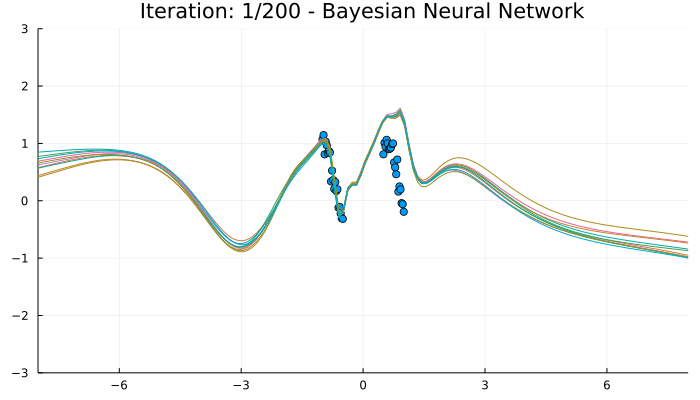

In [5]:
begin
    num_weights, prediction_fn, logprob, ensemble_prediction = make_neural_network_functions([1, 20, 20, 1], 0.1, 0.01, rbf)
    inputs, targets = build_dataset_1()
    log_posterior(weights) = logprob(weights, inputs, targets)
    objective = black_box_variational_inference(log_posterior, num_weights, mc_samples)
    param_hist, elbos = train_bayesian_neural_network(200, 0.1, num_weights, objective)
    animate_variational_params(inputs, targets, param_hist, number_of_models, prediction_fn)
end

In [6]:
begin
    # Save Figures
    for iter in [1,2,3, length(param_hist)]
        sample_and_plot(inputs, targets, param_hist[iter], 10, prediction_fn, "Iteration: "*string(iter)*"/"*string(length(param_hist))*" - Dataset 1", (-3, 3), (-8, 8), -8, 8, 150)
        fig = current()
        savefig(fig, "images/dataset_1_frame_$iter.png")
    end
end

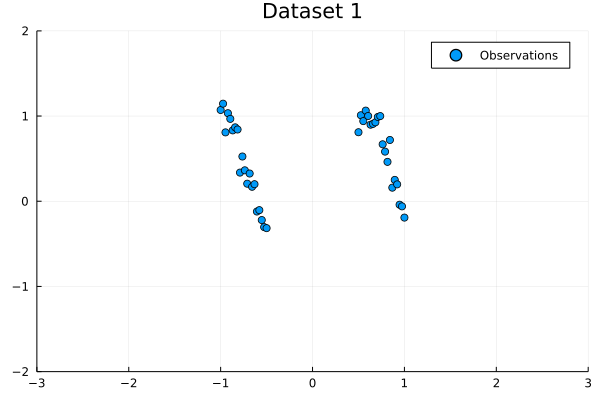

In [7]:
scatter(inputs, targets, label="Observations", title="Dataset 1", xlim=(-3, 3), ylim=(-2, 2))

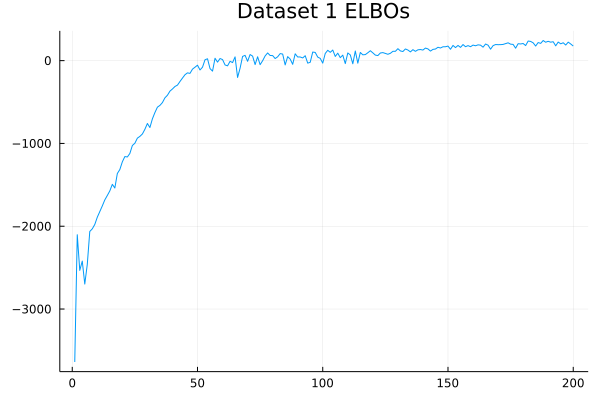

In [8]:
savefig(plot(elbos, title="Dataset 1 ELBOs", label=""), "images/dataset_1_elbos.png")
current()

## Dataset 2 Experiments

┌ Info: Saved animation to 
│   fn = C:\Users\andre\idea_projects\julia\CS5099\tmp.gif
└ @ Plots C:\Users\andre\.julia\packages\Plots\Ra8fG\src\animation.jl:126


Plots.AnimatedGif("C:\\Users\\andre\\idea_projects\\julia\\CS5099\\tmp.gif")
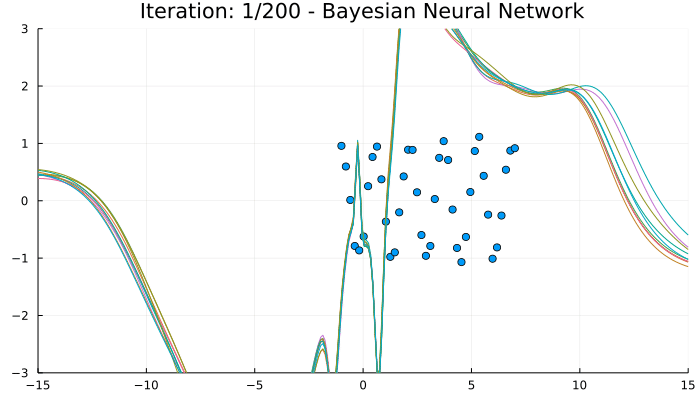

In [9]:
begin
    num_weights, prediction_fn, logprob, ensemble_prediction = make_neural_network_functions([1, 20, 20, 1], 0.1, 0.01, rbf)
    inputs, targets = build_dataset_2()
    log_posterior(weights) = logprob(weights, inputs, targets)
    objective = black_box_variational_inference(log_posterior, num_weights, mc_samples)
    param_hist, elbos = train_bayesian_neural_network(200, 0.1, num_weights, objective)
    animate_variational_params(inputs, targets, param_hist, number_of_models, prediction_fn, (-3, 3), (-15, 15), -15, 15, 300)
end

In [10]:
# Save Figures
for iter in [1,2,3, length(param_hist)]
    sample_and_plot(inputs, targets, param_hist[iter], 10, prediction_fn, "Iteration: "*string(iter)*"/"*string(length(param_hist))*" - Dataset 2", (-3, 3), (-15, 15), -15, 15, 150)
    fig = current()
    savefig(fig, "images/dataset_2_frame_$iter.png")
end

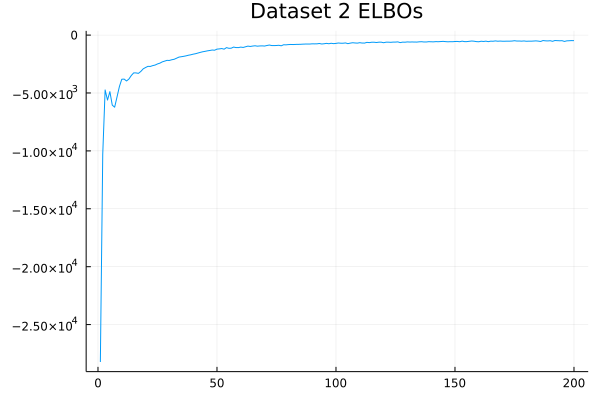

In [11]:
savefig(plot(elbos, title="Dataset 2 ELBOs",labels=""), "images/dataset_2_elbos.png")
current()

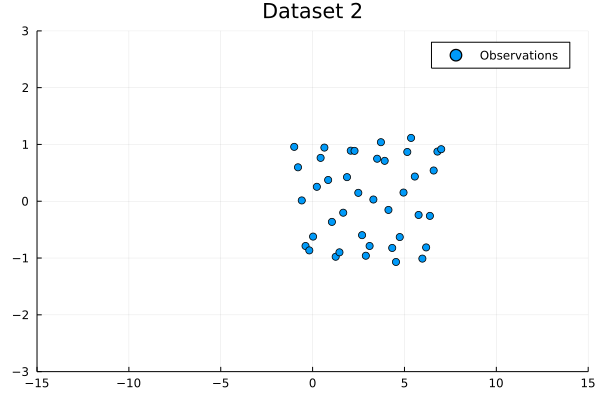

In [12]:
savefig(scatter(inputs, targets, label="Observations", title="Dataset 2", xlim=(-15, 15), ylim=(-3, 3)), "images/dataset_2.png")
current()

## Making Predictions

In [13]:
unseen_data = rand(100, 1);
no_ensemble_prediction = prediction_fn(sample_posteriors(param_hist[end]), unseen_data)
final_variational_param = param_hist[end]
ensemble_prediction(final_variational_param, unseen_data, 1)

1×100×1 Array{Float64, 3}:
[:, :, 1] =
 0.746454  0.237854  0.114793  0.51177  …  -0.485466  0.701744  0.0104985

## Dataset 3 Experiment

┌ Info: Saved animation to 
│   fn = C:\Users\andre\idea_projects\julia\CS5099\tmp.gif
└ @ Plots C:\Users\andre\.julia\packages\Plots\Ra8fG\src\animation.jl:126


Plots.AnimatedGif("C:\\Users\\andre\\idea_projects\\julia\\CS5099\\tmp.gif")
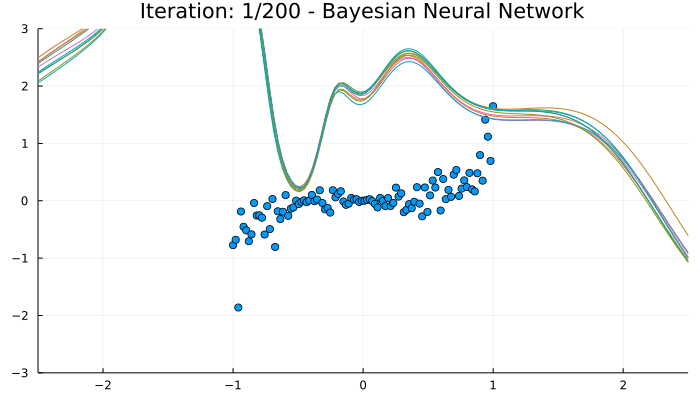

In [14]:
begin
    num_weights, prediction_fn, logprob, ensemble_prediction = make_neural_network_functions([1, 20, 20, 1], 0.1, 0.01, rbf)
    inputs, targets = build_dataset_3()
    log_posterior(weights) = logprob(weights, inputs, targets)
    objective = black_box_variational_inference(log_posterior, num_weights, mc_samples)
    param_hist, elbos = train_bayesian_neural_network(200, 0.1, num_weights, objective)
    animate_variational_params(inputs, targets, param_hist, number_of_models, prediction_fn, (-3, 3), (-2.5, 2.5), -2.5, 2.5, 150)
end

In [15]:
# Save Figures
for iter in [1,2,3, length(param_hist)]
    sample_and_plot(inputs, targets, param_hist[iter], 10, prediction_fn, "Iteration: "*string(iter)*"/"*string(length(param_hist))*" - Dataset 3", (-3, 3), (-2.5, 2.5), -2.5, 2.5, 150)
    fig = current()
    savefig(fig, "images/dataset_3_frame_$iter.png")
end

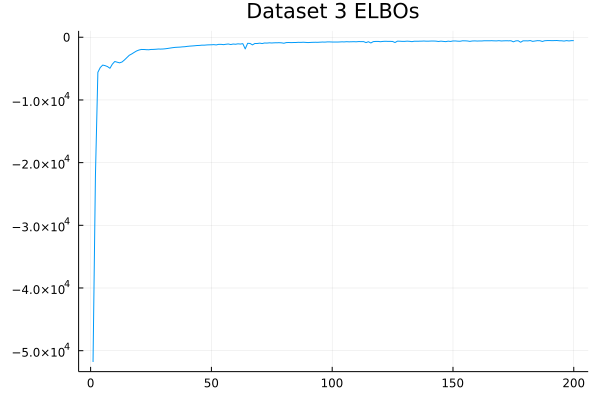

In [16]:
savefig(plot(elbos, title="Dataset 3 ELBOs",labels=""), "images/dataset_3_elbos.png")
current()

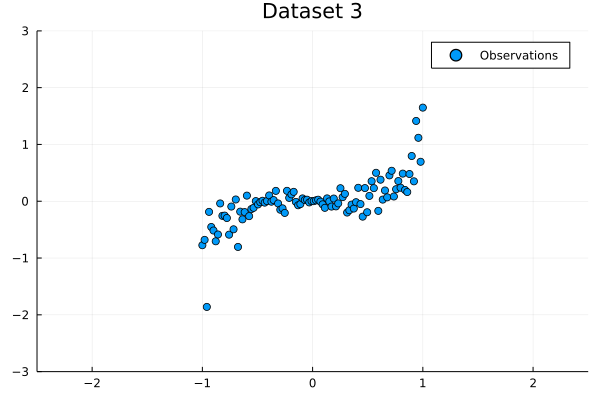

In [17]:
savefig(scatter(inputs, targets, label="Observations", title="Dataset 3", xlim=(-2.5, 2.5), ylim=(-3, 3)), "images/dataset_3.png")
current()

# Activation Functions Experiments

## ReLU

┌ Info: Saved animation to 
│   fn = C:\Users\andre\idea_projects\julia\CS5099\tmp.gif
└ @ Plots C:\Users\andre\.julia\packages\Plots\Ra8fG\src\animation.jl:126


Plots.AnimatedGif("C:\\Users\\andre\\idea_projects\\julia\\CS5099\\tmp.gif")
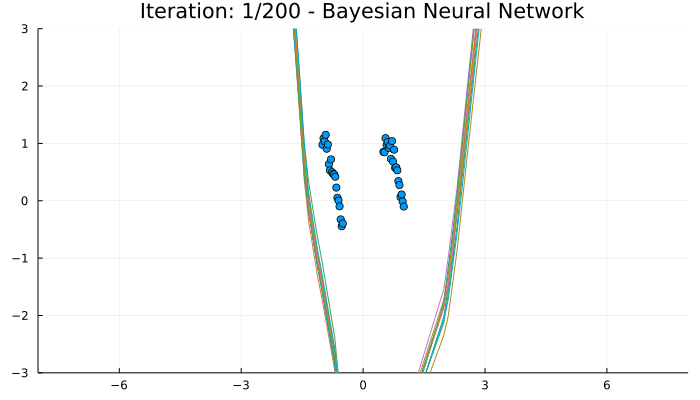

In [18]:
# Specify a few constants
Random.seed!(0)
number_of_models = 10
mc_samples = 20
num_weights, prediction_fn, logprob, ensemble_prediction = make_neural_network_functions([1, 20, 20, 1], 0.1, 0.01, relu)
inputs, targets = build_dataset_1()
log_posterior(weights) = logprob(weights, inputs, targets)
objective = black_box_variational_inference(log_posterior, num_weights, mc_samples)
param_hist, elbos = train_bayesian_neural_network(200, 0.1, num_weights, objective)
animate_variational_params(inputs, targets, param_hist, number_of_models, prediction_fn)

In [19]:
# Save Figures
for iter in [1,2,3, length(param_hist)]
    sample_and_plot(inputs, targets, param_hist[iter], 10, prediction_fn, "Iteration: "*string(iter)*"/"*string(length(param_hist))*" - Dataset 1", (-3, 3), (-8, 8), -8, 8, 150)
    fig = current()
    savefig(fig, "images/relu_frame_$iter.png")
end

## Sigmoid

┌ Info: Saved animation to 
│   fn = C:\Users\andre\idea_projects\julia\CS5099\tmp.gif
└ @ Plots C:\Users\andre\.julia\packages\Plots\Ra8fG\src\animation.jl:126


Plots.AnimatedGif("C:\\Users\\andre\\idea_projects\\julia\\CS5099\\tmp.gif")
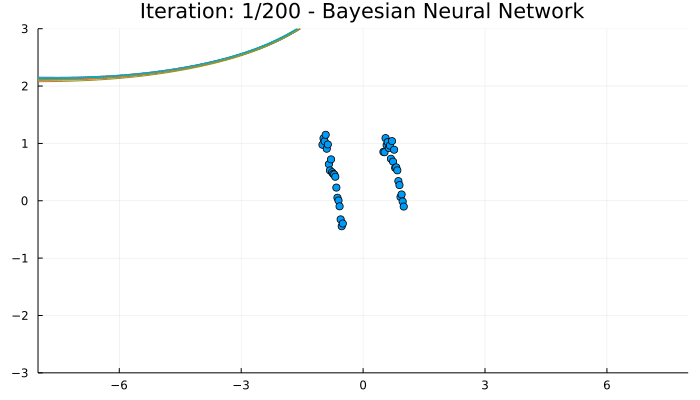

In [20]:
# Specify a few constants
Random.seed!(0)
number_of_models = 10
mc_samples = 20
num_weights, prediction_fn, logprob, ensemble_prediction = make_neural_network_functions([1, 20, 20, 1], 0.1, 0.01, sigmoid)
inputs, targets = build_dataset_1()
log_posterior(weights) = logprob(weights, inputs, targets)
objective = black_box_variational_inference(log_posterior, num_weights, mc_samples)
param_hist, elbos = train_bayesian_neural_network(200, 0.1, num_weights, objective)
animate_variational_params(inputs, targets, param_hist, number_of_models, prediction_fn)

In [21]:
# Save Figures
for iter in [1,2,3, length(param_hist)]
    sample_and_plot(inputs, targets, param_hist[iter], 10, prediction_fn, "Iteration: "*string(iter)*"/"*string(length(param_hist))*" - Dataset 1", (-3, 3), (-8, 8), -8, 8, 150)
    fig = current()
    savefig(fig, "images/sigmoid_frame_$iter.png")
end

## GELU

┌ Info: Saved animation to 
│   fn = C:\Users\andre\idea_projects\julia\CS5099\tmp.gif
└ @ Plots C:\Users\andre\.julia\packages\Plots\Ra8fG\src\animation.jl:126


Plots.AnimatedGif("C:\\Users\\andre\\idea_projects\\julia\\CS5099\\tmp.gif")
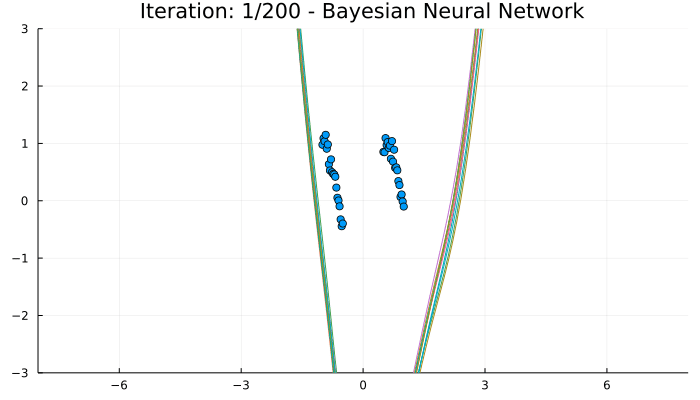

In [22]:
# Specify a few constants
Random.seed!(0)
number_of_models = 10
mc_samples = 20
num_weights, prediction_fn, logprob, ensemble_prediction = make_neural_network_functions([1, 20, 20, 1], 0.1, 0.01, gelu)
inputs, targets = build_dataset_1()
log_posterior(weights) = logprob(weights, inputs, targets)
objective = black_box_variational_inference(log_posterior, num_weights, mc_samples)
param_hist, elbos = train_bayesian_neural_network(200, 0.1, num_weights, objective)
animate_variational_params(inputs, targets, param_hist, number_of_models, prediction_fn)

In [23]:
# Save Figures
for iter in [1,2,3, length(param_hist)]
    sample_and_plot(inputs, targets, param_hist[iter], 10, prediction_fn, "Iteration: "*string(iter)*"/"*string(length(param_hist))*" - Dataset 1", (-3, 3), (-8, 8), -8, 8, 150)
    fig = current()
    savefig(fig, "images/gelu_frame_$iter.png")
end